In [1]:
pip install geopandas

Note: you may need to restart the kernel to use updated packages.


In [2]:
!pip install geopandas
!pip install matplotlib
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

gpkg_path = "C:/Users/Hp Elitebook/Desktop/python/final_data_20_24.gpkg" 
layer_name = None     

gdf = gpd.read_file(gpkg_path, layer=layer_name)

'pip' n'est pas reconnu en tant que commande interne
ou externe, un programme ex�cutable ou un fichier de commandes.
'pip' n'est pas reconnu en tant que commande interne
ou externe, un programme ex�cutable ou un fichier de commandes.


In [3]:
!pip install matplotlib

'pip' n'est pas reconnu en tant que commande interne
ou externe, un programme ex�cutable ou un fichier de commandes.


In [4]:
# Dictionary: INSEE code -> department name
insee_dept_dict = {
    "01": "Ain",
    "02": "Aisne",
    "03": "Allier",
    "04": "Alpes-de-Haute-Provence",
    "05": "Hautes-Alpes",
    "06": "Alpes-Maritimes",
    "07": "Ardèche",
    "08": "Ardennes",
    "09": "Ariège",
    "10": "Aube",
    "11": "Aude",
    "12": "Aveyron",
    "13": "Bouches-du-Rhône",
    "14": "Calvados",
    "15": "Cantal",
    "16": "Charente",
    "17": "Charente-Maritime",
    "18": "Cher",
    "19": "Corrèze",
    "2A": "Corse-du-Sud",
    "2B": "Haute-Corse",
    "21": "Côte-d'Or",
    "22": "Côtes-d'Armor",
    "23": "Creuse",
    "24": "Dordogne",
    "25": "Doubs",
    "26": "Drôme",
    "27": "Eure",
    "28": "Eure-et-Loir",
    "29": "Finistère",
    "30": "Gard",
    "31": "Haute-Garonne",
    "32": "Gers",
    "33": "Gironde",
    "34": "Hérault",
    "35": "Ille-et-Vilaine",
    "36": "Indre",
    "37": "Indre-et-Loire",
    "38": "Isère",
    "39": "Jura",
    "40": "Landes",
    "41": "Loir-et-Cher",
    "42": "Loire",
    "43": "Haute-Loire",
    "44": "Loire-Atlantique",
    "45": "Loiret",
    "46": "Lot",
    "47": "Lot-et-Garonne",
    "48": "Lozère",
    "49": "Maine-et-Loire",
    "50": "Manche",
    "51": "Marne",
    "52": "Haute-Marne",
    "53": "Mayenne",
    "54": "Meurthe-et-Moselle",
    "55": "Meuse",
    "56": "Morbihan",
    "57": "Moselle",
    "58": "Nièvre",
    "59": "Nord",
    "60": "Oise",
    "61": "Orne",
    "62": "Pas-de-Calais",
    "63": "Puy-de-Dôme",
    "64": "Pyrénées-Atlantiques",
    "65": "Hautes-Pyrénées",
    "66": "Pyrénées-Orientales",
    "67": "Bas-Rhin",
    "68": "Haut-Rhin",
    "69": "Rhône",
    "70": "Haute-Saône",
    "71": "Saône-et-Loire",
    "72": "Sarthe",
    "73": "Savoie",
    "74": "Haute-Savoie",
    "75": "Paris",
    "76": "Seine-Maritime",
    "77": "Seine-et-Marne",
    "78": "Yvelines",
    "79": "Deux-Sèvres",
    "80": "Somme",
    "81": "Tarn",
    "82": "Tarn-et-Garonne",
    "83": "Var",
    "84": "Vaucluse",
    "85": "Vendée",
    "86": "Vienne",
    "87": "Haute-Vienne",
    "88": "Vosges",
    "89": "Yonne",
    "90": "Territoire de Belfort",
    "91": "Essonne",
    "92": "Hauts-de-Seine",
    "93": "Seine-Saint-Denis",
    "94": "Val-de-Marne",
    "95": "Val-d'Oise",
    "971": "Guadeloupe",
    "972": "Martinique",
    "973": "Guyane",
    "974": "La Réunion",
    "976": "Mayotte"
}

gdf["dept_name"] = gdf["code_insee_du_departement"].map(insee_dept_dict)

In [5]:
insee_region_dict = {
    "01": "Guadeloupe",
    "02": "Martinique",
    "03": "Guyane",
    "04": "La Réunion",
    "06": "Mayotte",
    "11": "Île-de-France",
    "24": "Centre-Val de Loire",
    "27": "Bourgogne-Franche-Comté",
    "28": "Normandie",
    "32": "Hauts-de-France",
    "44": "Grand Est",
    "52": "Pays de la Loire",
    "53": "Bretagne",
    "75": "Nouvelle-Aquitaine",
    "76": "Occitanie",
    "84": "Auvergne-Rhône-Alpes",
    "93": "Provence-Alpes-Côte d'Azur",
    "94": "Corse"
}

gdf["region_name"] = gdf["code_insee_de_la_region"].map(insee_region_dict)

### B- Analyse quantitative

In [6]:
gdf["date"] = pd.to_datetime(gdf["ym"].astype(str), errors="coerce")
gdf["year"] = gdf["date"].dt.year
gdf["month"] = gdf["date"].dt.month

swi_vars = [
    "SWI_UNIF_MENS",
    "swi_mean"
]

clim_vars = [
    "prenei_sum", "preliq_sum", "pe_sum", "evap_sum",
    "t_avg", "ff_avg", "q_avg", "hu_avg", "ssi_avg",
    "etp_avg", "tinf_avg", "tsup_avg",
    "resr_neige_avg", "snow_frac_avg",
    "drainc_sum", "runc_sum", "ecoulement_sum",
    "wg_racine_avg", "wgi_racine_avg"
]

region_id = "code_insee_de_la_region"

# 3) Statistiques descriptives (SWI)
stats_desc = gdf[swi_vars].agg(
    ["mean", "std", "min", "max"]
)

print("\nStatistiques descriptives SWI ")
print(stats_desc)


Statistiques descriptives SWI 
      SWI_UNIF_MENS  swi_mean
mean       0.578919  0.633205
std        0.332121  0.269058
min       -0.041000 -0.015452
max        1.344000  1.500433


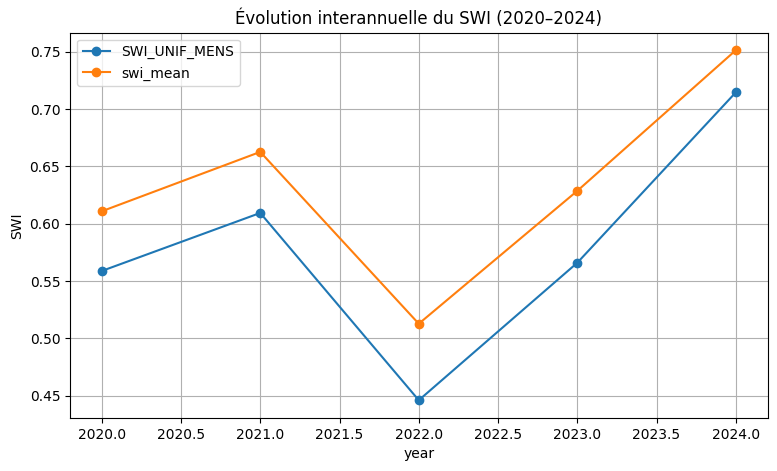

In [7]:

# -----------------------------------------------------
# 4) Évolution temporelle interannuelle
# -----------------------------------------------------
annual_swi = (
    gdf
    .groupby("year")[swi_vars]
    .mean()
    .reset_index()
)

annual_swi.set_index("year").plot(
    marker="o",
    figsize=(9, 5),
    title="Évolution interannuelle du SWI (2020–2024)"
)
plt.ylabel("SWI")
plt.grid(True)
plt.show()


#### On remarque que la sechéresse est très élevé en 2022


Mois les plus secs (SWI_UNIF_MENS le plus faible) :
   month  SWI_UNIF_MENS  swi_mean
8      9       0.173919  0.333393
7      8       0.181575  0.316909
6      7       0.307865  0.401742


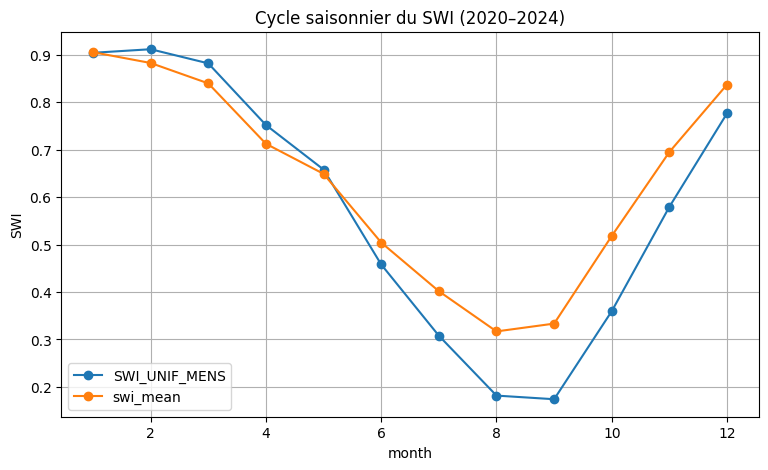

In [8]:

# -----------------------------------------------------
# 5) Analyse mensuelle (cycle saisonnier)
# -----------------------------------------------------
monthly_swi = (
    gdf
    .groupby("month")[swi_vars]
    .mean()
    .reset_index()
)

print("\nMois les plus secs (SWI_UNIF_MENS le plus faible) :")
print(monthly_swi.sort_values("SWI_UNIF_MENS").head(3))

monthly_swi.set_index("month").plot(
    marker="o",
    figsize=(9, 5),
    title="Cycle saisonnier du SWI (2020–2024)"
)
plt.ylabel("SWI")
plt.grid(True)
plt.show()


#### On remarque que la valeur du swi moyen et celui du swi uniforme sont identique dans le 5ieme mois. En plus, ils ont des tendances proches et le mois d'Aoùt et Septembre sont ceux dans laquelle la secheresse est la plus élevé.

In [9]:
# 6) Agrégation régionale
# a) Moyenne annuelle régionale
regional_annual = (
    gdf
    .groupby([region_id, "year"])["SWI_UNIF_MENS"]
    .mean()
    .reset_index()
)

print("\nAperçu agrégation régionale annuelle :")
regional_annual.head


Aperçu agrégation régionale annuelle :


<bound method NDFrame.head of    code_insee_de_la_region  year  SWI_UNIF_MENS
0                       11  2020       0.476846
1                       11  2021       0.617199
2                       11  2022       0.407819
3                       11  2023       0.521949
4                       11  2024       0.771033
..                     ...   ...            ...
60                      94  2020       0.454549
61                      94  2021       0.457747
62                      94  2022       0.350288
63                      94  2023       0.394095
64                      94  2024       0.372116

[65 rows x 3 columns]>

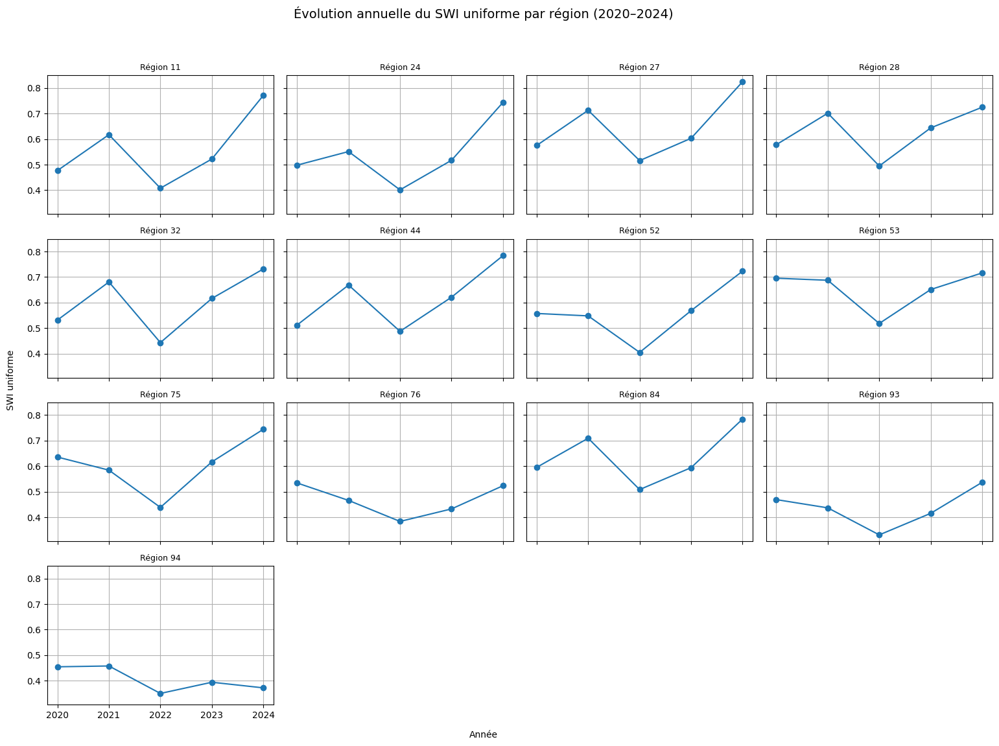

In [10]:
import matplotlib.pyplot as plt
import math
regions = regional_annual[region_id].unique()
n_regions = len(regions)

n_cols = 4          
n_rows = math.ceil(n_regions / n_cols)

fig, axes = plt.subplots(
    n_rows, n_cols,
    figsize=(4 * n_cols, 3 * n_rows),
    sharex=True,
    sharey=True
)

axes = axes.flatten()

for i, region in enumerate(regions):
    ax = axes[i]
    sub = regional_annual[regional_annual[region_id] == region]

    ax.plot(
        sub["year"],
        sub["SWI_UNIF_MENS"],
        marker="o"
    )

    ax.set_title(f"Région {region}", fontsize=9)
    ax.grid(True)

# Supprimer les axes vides
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Titres communs
fig.suptitle(
    "Évolution annuelle du SWI uniforme par région (2020–2024)",
    fontsize=14
)
fig.text(0.5, 0.04, "Année", ha="center")
fig.text(0.04, 0.5, "SWI uniforme", va="center", rotation="vertical")

plt.tight_layout(rect=[0.05, 0.05, 1, 0.95])
plt.show()


#### Pour l’année 2024, on lit la dernière valeur de chaque courbe : certaines régions ont un SWI assez élevé, par exemple 11, 24, 27, 28, 32, 44, 52, 53, 75, 84 (points de 2024 en haut de leur petit graphique), ce qui indique des sols plutôt humides en 2024. d’autres restent plus sèches, notamment la région 94 qui a le niveau de SWI le plus bas en 2024 parmi toutes les régions, et la 76 ou 93 qui restent aussi en dessous des autres. On voit aussi que, pour beaucoup de régions, le SWI remonte nettement entre 2022 et 2024 (pente ascendante sur les deux derniers points), ce qui suggère un retour à des conditions plus humides après un creux en 2022.


In [11]:
# b) Moyenne mensuelle régionale
regional_monthly = (
    gdf
    .groupby([region_id, "month"])["SWI_UNIF_MENS"]
    .mean()
    .reset_index()
)
regional_monthly 

,code_insee_de_la_region,month,SWI_UNIF_MENS
0,11,1,0.863853
1,11,2,0.908651
2,11,3,0.872967
3,11,4,0.758542
4,11,5,0.621135
...,...,...,...
151,94,8,-0.008867
152,94,9,0.025429
153,94,10,0.144592
154,94,11,0.366338


In [12]:
pip install seaborn

Note: you may need to restart the kernel to use updated packages.


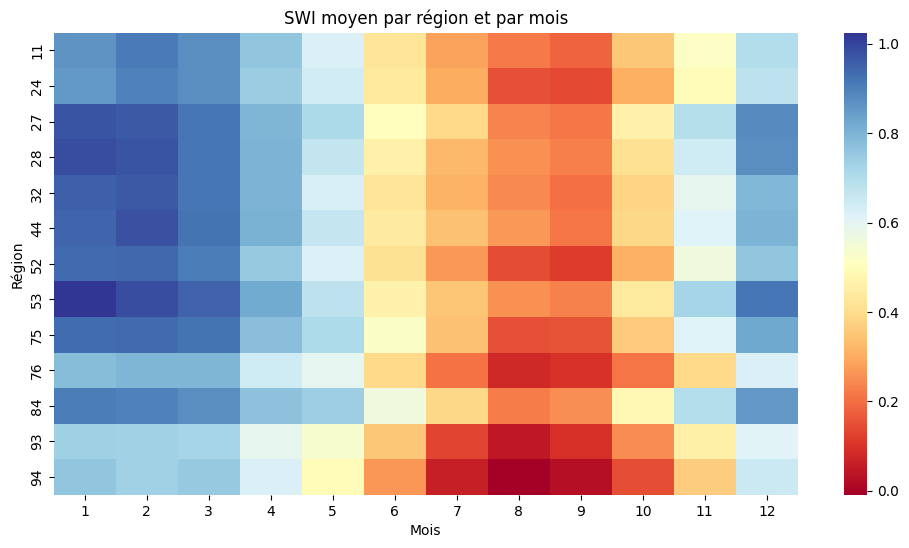

In [13]:
import seaborn as sns

heatmap_df = regional_monthly.pivot(
    index=region_id,
    columns="month",
    values="SWI_UNIF_MENS"
)

plt.figure(figsize=(12, 6))
sns.heatmap(
    heatmap_df,
    cmap="RdYlBu",
    annot=False
)

plt.title("SWI moyen par région et par mois")
plt.xlabel("Mois")
plt.ylabel("Région")
plt.show()


##### Les mois d’hiver et de début de printemps (1 à 4–5) sont globalement plus humides, avec des valeurs de SWI élevées en bleu. Les mois d’été (6 à 8–9) sont nettement plus secs, surtout dans certaines régions comme 93 et 94 qui présentent des SWI très faibles. Quelques régions (par exemple 27 et 84) restent relativement plus humides que les autres sur l’ensemble de l’année

### C-Aperçus qualitatifs de la sécheresse régionale

c:\Users\Hp Elitebook\AppData\Local\Programs\Python\Python313\Lib\site-packages\pyogrio\raw.py:198: RuntimeWarning: Field format 'character varying' not supported
  return ogr_read(
c:\Users\Hp Elitebook\AppData\Local\Programs\Python\Python313\Lib\site-packages\pyogrio\raw.py:198: RuntimeWarning: Field format 'character varying(256)' not supported
  return ogr_read(
c:\Users\Hp Elitebook\AppData\Local\Programs\Python\Python313\Lib\site-packages\pyogrio\raw.py:198: RuntimeWarning: Field format 'character varying(30)' not supported
  return ogr_read(
c:\Users\Hp Elitebook\AppData\Local\Programs\Python\Python313\Lib\site-packages\pyogrio\raw.py:198: RuntimeWarning: Field format 'timestamp with time zone' not supported
  return ogr_read(
c:\Users\Hp Elitebook\AppData\Local\Programs\Python\Python313\Lib\site-packages\pyogrio\geopandas.py:275: UserWarning: More than one layer found in 'ADE_4-0_GPKG_LAMB93_FXX-ED2025-11-20.gpkg': 'canton' (default), 'arrondissement', 'arrondissement_municipal

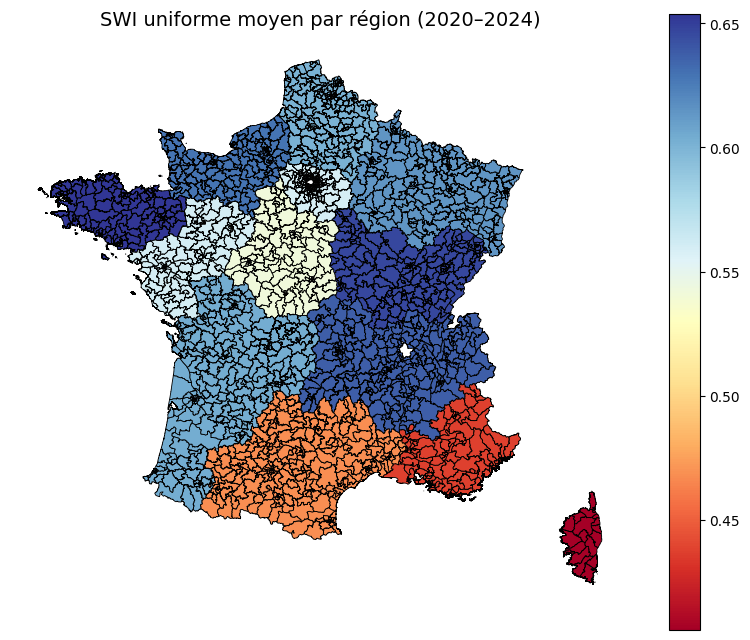

In [14]:
region_id = "code_insee_de_la_region"

regional_mean = (
    gdf
    .groupby(region_id)["SWI_UNIF_MENS"]
    .mean()
    .reset_index()
)
admin_regions = gpd.read_file("C:/Users/Hp Elitebook/Desktop/python/ADE_4-0_GPKG_LAMB93_FXX-ED2025-11-20.gpkg")

# Vérification CRS
admin_regions = admin_regions.to_crs("EPSG:2154")

admin_regions = admin_regions[[region_id, "geometry"]]

map_gdf = admin_regions.merge(
    regional_mean,
    on=region_id,
    how="left"
)

fig, ax = plt.subplots(figsize=(10, 8))

map_gdf.plot(
    column="SWI_UNIF_MENS",
    cmap="RdYlBu",
    legend=True,
    edgecolor="black",
    linewidth=0.6,
    ax=ax
)

ax.set_title("SWI uniforme moyen par région (2020–2024)", fontsize=14)
ax.axis("off")

plt.show()


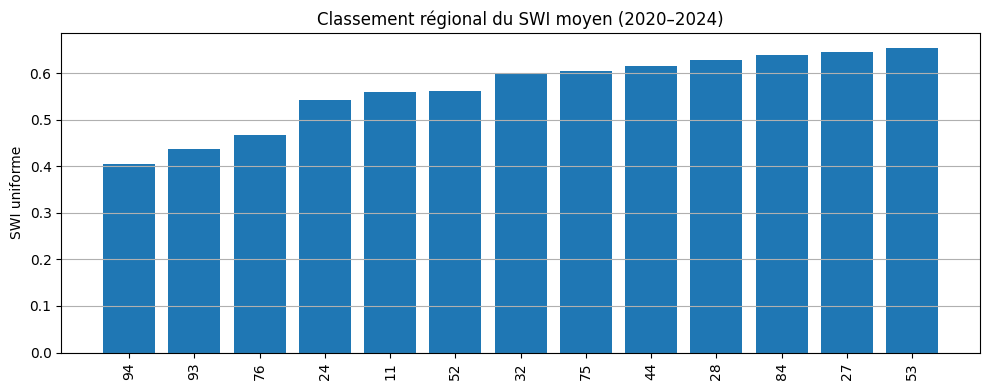

In [15]:
regional_mean_sorted = regional_mean.sort_values("SWI_UNIF_MENS")

plt.figure(figsize=(10, 4))
plt.bar(
    regional_mean_sorted[region_id],
    regional_mean_sorted["SWI_UNIF_MENS"]
)
plt.title("Classement régional du SWI moyen (2020–2024)")
plt.ylabel("SWI uniforme")
plt.xticks(rotation=90)
plt.grid(axis="y")
plt.tight_layout()
plt.show()


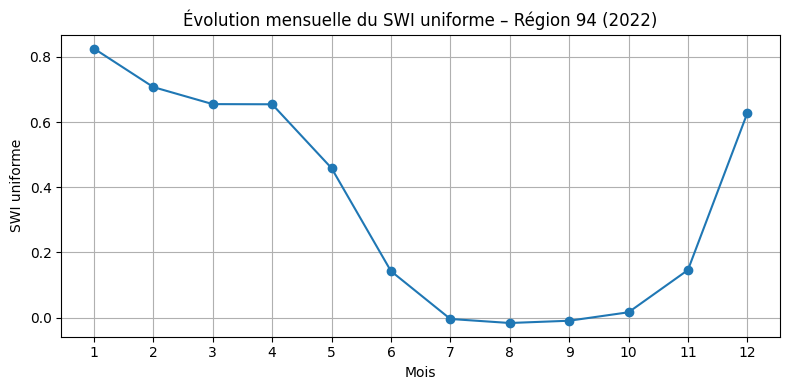

In [16]:
region_code = "94"
year_selected = 2022

swi_94 = (
    gdf[
        (gdf["code_insee_de_la_region"] == region_code) &
        (gdf["year"] == year_selected)
    ]
    .groupby("month")["SWI_UNIF_MENS"]
    .mean()
    .reset_index()
)

plt.figure(figsize=(8, 4))

plt.plot(
    swi_94["month"],
    swi_94["SWI_UNIF_MENS"],
    marker="o"
)

plt.title(
    f"Évolution mensuelle du SWI uniforme – Région {region_code} ({year_selected})"
)
plt.xlabel("Mois")
plt.ylabel("SWI uniforme")
plt.grid(True)
plt.xticks(range(1, 13))

plt.tight_layout()
plt.show()


#### MOdelisation
##### Reg lineaire

In [17]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, mean_absolute_error


In [18]:
numeric_features = [
    "swi_mean", "swi_min", "swi_max",
    "prenei_sum", "preliq_sum",
    "pe_sum", "evap_sum", "etp_avg",
    "t_avg", "tinf_avg", "tsup_avg",
    "hu_avg", "q_avg", "ff_avg",
    "dli_avg", "ssi_avg",
    "drainc_sum", "runc_sum", "ecoulement_sum",
    "resr_neige_avg", "resr_neige6_avg",
    "hteurneige_avg", "hteurneige6_avg", "hteurneigex_avg",
    "snow_frac_avg",
    "wg_racine_avg", "wgi_racine_avg"
]
df=gdf
categorical_features = ["NIVEAU","region_name"]
target = "SWI_UNIF_MENS"
df["year"] = pd.to_datetime(df["ym"]).dt.year

df_train = df[(df["year"] >= 2020) & (df["year"] <= 2023)]
df_test  = df[df["year"] == 2024]
X_train = df_train[numeric_features + categorical_features]
y_train = df_train[target]

X_test = df_test[numeric_features + categorical_features]
y_test = df_test[target]


In [19]:
preprocessor = ColumnTransformer(
    transformers=[
        ("num", StandardScaler(), numeric_features),
        ("cat", OneHotEncoder(drop="first", handle_unknown="ignore"), categorical_features)
    ]
)

model = Pipeline(
    steps=[
        ("preprocess", preprocessor),
        ("regressor", LinearRegression())
    ]
)

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mae = mean_absolute_error(y_test, y_pred)

print("Évaluation sur 2024")
print(f"RMSE : {rmse:.3f}")
print(f"MAE  : {mae:.3f}")


Évaluation sur 2024
RMSE : 0.066
MAE  : 0.052


Le modèle de régression linéaire construit ici vise à estimer le SWI Uniforme à partir d’indicateurs locaux, en utilisant le SWI SAFRAN, les caractéristiques de sol et des covariables climatiques ou géographiques comme variables explicatives. Il fournit ainsi une approximation simple et transparente de l’indicateur standardisé, tout en restant directement interprétable du point de vue statistique.

Sur l’année 2024, les performances obtenues (RMSE = 0,066 et MAE = 0,052) montrent que, en moyenne, les prédictions du modèle restent proches des valeurs observées de SWI Uniforme, avec peu d’erreurs extrêmes. Ces résultats confirment l’intérêt de cette régression comme modèle de référence (« baseline ») pour quantifier l’écart entre information locale et indicateur uniforme, et pour identifier ensuite, via l’analyse détaillée des résidus, les contextes où la standardisation nationale pourrait moins bien représenter les conditions locales.

### Kriging, Variogramme et carte

<Axes: >

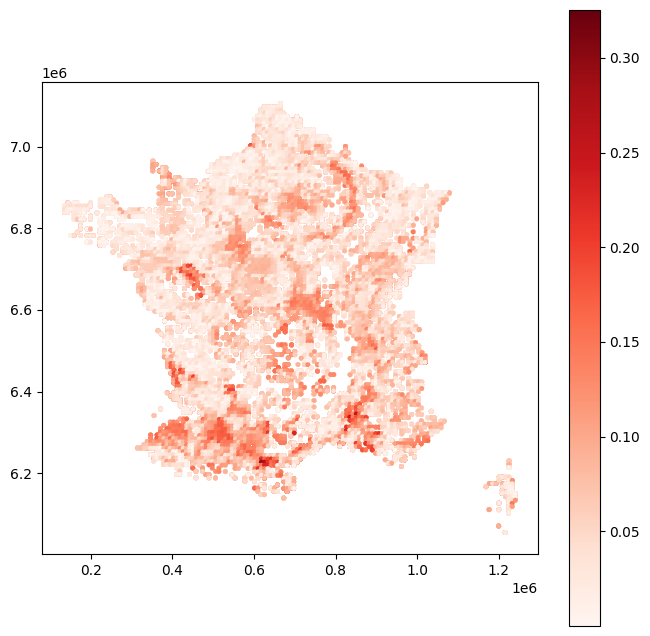

In [20]:
gdf_test = df_test.copy()

gdf_test["residu"] = y_test - y_pred
gdf_test["abs_residu"] = np.abs(gdf_test["residu"])
gdf_test.plot(
    column="abs_residu",
    cmap="Reds",
    legend=True,
    figsize=(8, 8),
    markersize=6
)


<Axes: >

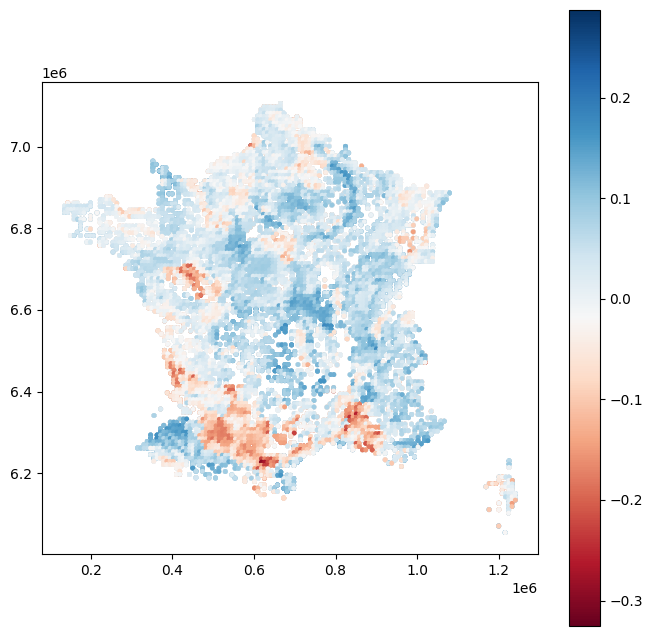

In [21]:
gdf_test.plot(
    column="residu",
    cmap="RdBu",
    legend=True,
    figsize=(8, 8),
    markersize=6
)


In [22]:
pip install pandas numpy geopandas shapely pyproj scikit-learn matplotlib seaborn pykrige scikit-gstat scipy


Note: you may need to restart the kernel to use updated packages.


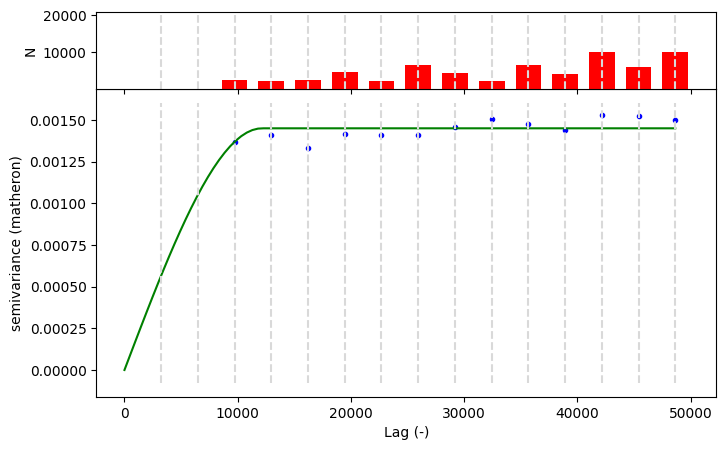

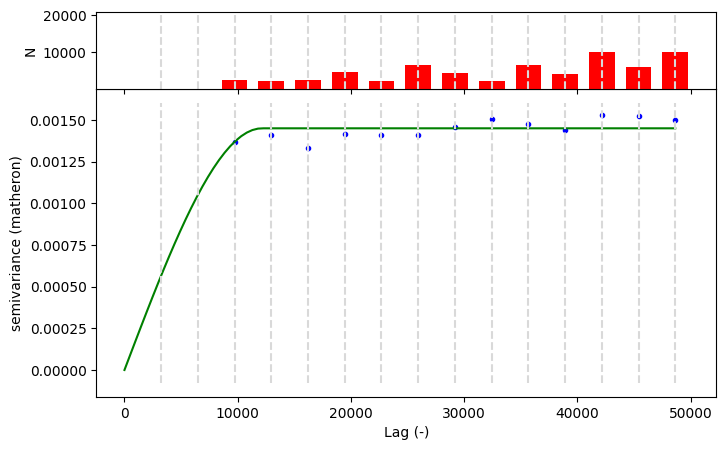

In [23]:
gdf_test = df_test.copy()
gdf_test["SWI_obs"] = y_test.values
gdf_test["SWI_pred"] = y_pred
gdf_test["residu"] = gdf_test["SWI_obs"] - gdf_test["SWI_pred"]
gdf_test["abs_residu"] = gdf_test["residu"].abs()

gdf_test = gdf_test.to_crs(epsg=2154)

gdf_test["x"] = gdf_test.geometry.x
gdf_test["y"] = gdf_test.geometry.y

from skgstat import Variogram
gdf_vario = gdf_test.sample(n=3000, random_state=42)

V = Variogram(
    gdf_vario[["x", "y"]].values,
    gdf_vario["abs_residu"].values,
    model="spherical",
    maxlag=50000,     # 50 km (adaptable)
    n_lags=15
)
V.plot()


In [24]:
gdf_krig = gdf_test.sample(n=3000, random_state=42)
xmin, ymin, xmax, ymax = gdf_test.total_bounds

grid_x = np.linspace(xmin, xmax, 150)
grid_y = np.linspace(ymin, ymax, 150)
from pykrige.ok import OrdinaryKriging

OK = OrdinaryKriging(
    gdf_krig["x"].values,
    gdf_krig["y"].values,
    gdf_krig["abs_residu"].values,
    variogram_model="spherical",
    nlags=15,
    verbose=False
)

z_error, z_var = OK.execute("grid", grid_x, grid_y)


KeyError: 'x'

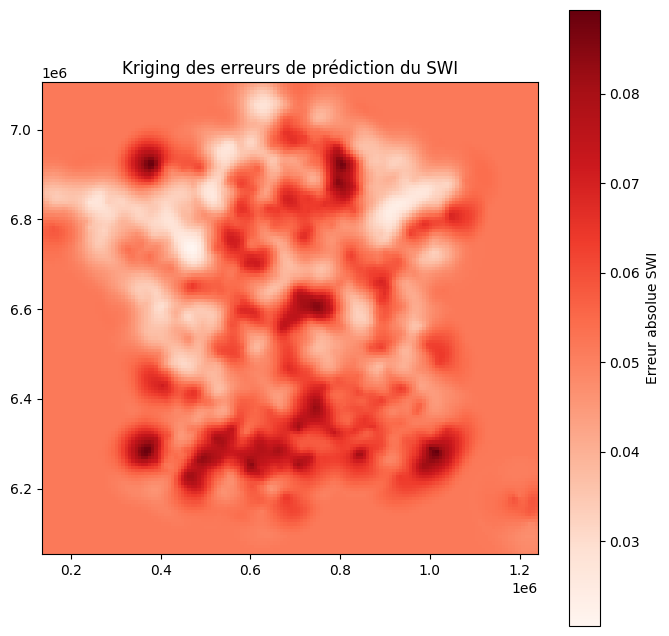

In [25]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 8))
plt.imshow(
    z_error,
    extent=(xmin, xmax, ymin, ymax),
    origin="lower",
    cmap="Reds"
)
plt.colorbar(label="Erreur absolue SWI")
plt.title("Kriging des erreurs de prédiction du SWI")
plt.scatter(gdf["x"], gdf["y"], s=2, c="black", alpha=0.3)
plt.show()


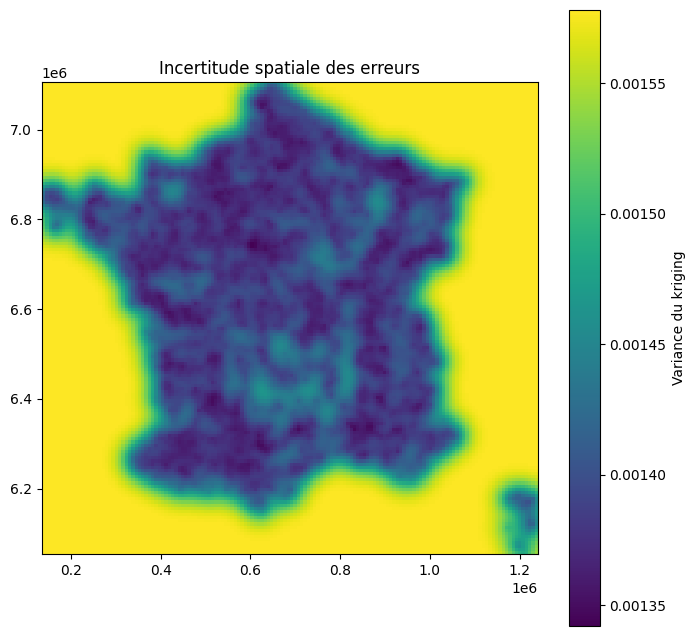

In [ ]:
plt.figure(figsize=(8, 8))
plt.imshow(
    z_var,
    extent=(xmin, xmax, ymin, ymax),
    origin="lower",
    cmap="viridis"
)
plt.colorbar(label="Variance du kriging")
plt.title("Incertitude spatiale des erreurs")
plt.show()


In [26]:
!pip install folium mapclassify scikit-learn


'pip' n'est pas reconnu en tant que commande interne
ou externe, un programme ex�cutable ou un fichier de commandes.


In [27]:
import geopandas as gpd
import pandas as pd
import numpy as np

# =========================
# 1. Préparer le GeoDataFrame 2024
# =========================
gdf_test = gpd.GeoDataFrame(df_test.copy(), geometry="geometry")

# S'assurer que ym est bien en datetime
gdf_test["ym"] = pd.to_datetime(gdf_test["ym"])

# Extraire le trimestre
gdf_test["quarter"] = gdf_test["ym"].dt.to_period("Q").astype(str)

# =========================
# 2. Calcul des erreurs
# =========================
gdf_test["error"] = y_test.values - y_pred
gdf_test["abs_error"] = np.abs(gdf_test["error"])
gdf_test["sq_error"] = gdf_test["error"] ** 2

# =========================
# 3. Agrégation par geometry × trimestre
# =========================
agg_quarter_point = (
    gdf_test
    .groupby(["geometry", "quarter"])
    .agg(
        mae_point=("abs_error", "mean"),
        rmse_point=("sq_error", lambda x: np.sqrt(x.mean()))
    )
    .reset_index()
)

agg_quarter_gdf = gpd.GeoDataFrame(
    agg_quarter_point,
    geometry="geometry",
    crs=gdf_test.crs
)

# =========================
# 4. Cartes interactives MAE par trimestre
# =========================
for q in sorted(agg_quarter_gdf["quarter"].unique()):
    print(f"Carte RMSE - Trimestre {q}")
    display(
        agg_quarter_gdf[agg_quarter_gdf["quarter"] == q]
        .explore(
            column="rmse_point",
            cmap="OrRd",
            scheme="quantiles",
            legend=True,
            tooltip=["quarter", "rmse_point"],
            marker_kwds={"radius": 5, "fillOpacity": 0.7},
            tiles="CartoDB positron",
            zoom_start=5
        )
    )


Carte RMSE - Trimestre 2024Q1


Carte RMSE - Trimestre 2024Q2


Carte RMSE - Trimestre 2024Q3


Carte RMSE - Trimestre 2024Q4


### Analyse des erreurs temporelles et spatiales du modèle linéaire  

Les cartes trimestrielles du RMSE montrent d’abord que les performances du modèle de régression linéaire restent globalement stables dans l’espace, avec une majorité de communes présentant des erreurs modérées et relativement homogènes. Les zones les plus sombres, plus ponctuelles, signalent toutefois des poches où l’écart entre SWI Uniforme observé et prédit est plus important, suggérant un ajustement moins bon du modèle dans certains contextes locaux. Sur le plan temporel, la comparaison visuelle des quatre trimestres suggère des variations de niveau moyen d’erreur: certains trimestres présentent une intensité globale légèrement plus marquée, ce qui indique une dégradation relative des performances à certaines périodes de l’année, possiblement liée à des conditions hydrologiques ou climatiques plus extrêmes. Spatialement, les zones à fort RMSE ne sont pas strictement fixes d’un trimestre à l’autre, ce qui laisse penser que l’inadéquation du modèle n’est pas propre à un petit groupe de régions immuables, mais dépend aussi de la saison et des épisodes hydrologiques associés.

L’analyse des cartes trimestrielles met en outre en évidence un noyau récurrent de régions où le RMSE est plus élevé que la moyenne nationale, indiquant que la régression linéaire peine davantage à reproduire le SWI Uniforme dans ces contextes. Ces zones apparaissent de façon répétée au fil des trimestres, même si leur intensité relative varie, ce qui suggère des effets locaux persistants liés aux caractéristiques de sol ou aux régimes climatiques propres à ces territoires. Sur certaines cartes, les erreurs élevées semblent particulièrement concentrées au sud‑ouest (Nouvelle‑Aquitaine), au sud‑est (Provence‑Alpes‑Côte d’Azur et plus largement le pourtour méditerranéen), dans un axe central/nord‑est (Auvergne‑Rhône‑Alpes vers Grand Est), ainsi que sur la Corse. Le fait que ces mêmes ensembles spatiaux ressortent fréquemment comme foyers d’erreur suggère des effets locaux persistants: combinaison spécifique de types de sols sensibles à la sécheresse, de régimes climatiques particuliers ou de pratiques de mesure, pour lesquels une simple relation linéaire entre SWI SAFRAN et SWI Uniforme est insuffisante pour capturer toute la complexité des ajustements opérés dans l’indicateur national.  

Cette récurrence fait de ces régions des candidates naturelles pour des investigations ciblées: affinage des covariables, tests de modèles non linéaires, ou analyses complémentaires des conditions hydrologiques. Elle indique aussi que, dans ces espaces, l’indicateur SWI Uniforme résulte d’une transformation plus complexe de l’information locale, et que les écarts entre modèle linéaire et réalité pourraient éclairer les discussions sur la représentativité de l’indicateur dans le cadre CatNat. 

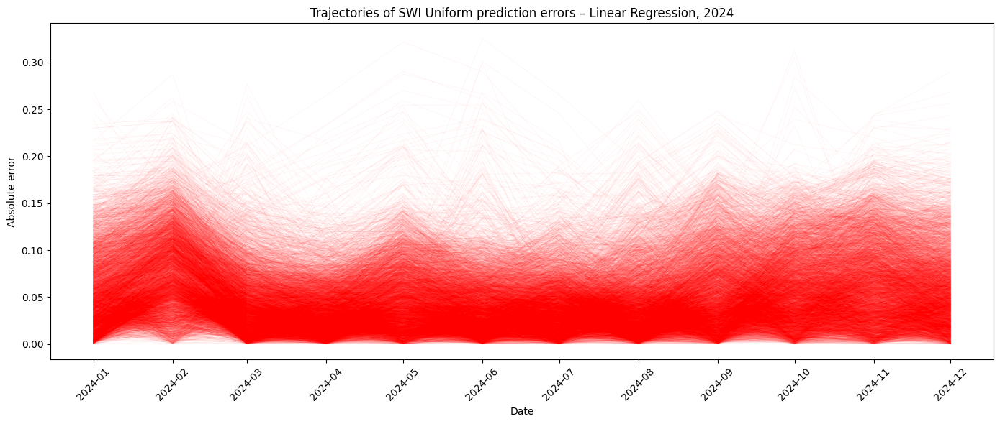

In [32]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# 1. Filtrer 2024 dans ton df complet
df_2024 = gdf[gdf['ym'].str.startswith('2024')].copy()

# 2. Reconstituer X_2024 comme pour l'entraînement
X_2024 = df_2024[ numeric_features + categorical_features ]
y_2024 = df_2024['SWI_UNIF_MENS']

# 3. Prédictions avec le pipeline (prétraitement + régression linéaire)
y_pred_2024 = model.predict(X_2024)

# 4. Ajouter prédiction et erreur absolue
df_2024['y_pred'] = y_pred_2024
df_2024['error'] = np.abs(df_2024['y_pred'] - y_2024)

# 5. Date à partir de ym
df_2024['ym_dt'] = pd.to_datetime(df_2024['ym'], format='%Y-%m')

# 6. Plot des trajectoires d’erreur par géométrie
fig, ax = plt.subplots(figsize=(14, 6))

for _, g in df_2024.groupby('geometry'):
    ax.plot(
        g['ym_dt'],
        g['error'],
        linewidth=0.5,
        alpha=0.05,
        color='red'
    )

ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

ax.set_xlabel('Date')
ax.set_ylabel('Absolute error')
ax.set_title('Trajectories of SWI Uniform prediction errors – Linear Regression, 2024')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


La visualisation des trajectoires d’erreur absolue pour l’ensemble des points en 2024 confirme ces résultats temporels. Le « rideau » de courbes montre qu’une large majorité des erreurs restent concentrées dans une bande relativement basse, ce qui traduit une bonne stabilité globale du modèle linéaire. On observe toutefois quelques pics mensuels où la densité des courbes s’épaissit vers des valeurs plus élevées, indiquant des périodes où de nombreux points présentent simultanément une erreur accrue. Ces épisodes renforcent l’idée que la capacité du modèle à reproduire le SWI Uniforme varie selon la saison et que certaines configurations hydrologiques sont plus difficiles à capturer avec une relation linéaire.

##### Random forest

In [34]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error

from scipy.stats import randint

numeric_features = [
    "swi_mean", "swi_min", "swi_max",
    "prenei_sum", "preliq_sum",
    "pe_sum", "evap_sum", "etp_avg",
    "t_avg", "tinf_avg", "tsup_avg",
    "hu_avg", "q_avg", "ff_avg",
    "dli_avg", "ssi_avg",
    "drainc_sum", "runc_sum", "ecoulement_sum",
    "resr_neige_avg", "resr_neige6_avg",
    "hteurneige_avg", "hteurneige6_avg", "hteurneigex_avg",
    "snow_frac_avg",
    "wg_racine_avg", "wgi_racine_avg"
]

categorical_features = ["NIVEAU", "region_name"]
target = "SWI_UNIF_MENS"
df["year"] = pd.to_datetime(df["ym"]).dt.year

df_train = df[(df["year"] >= 2020) & (df["year"] <= 2023)]
df_test  = df[df["year"] == 2024]
X_train = df_train[numeric_features + categorical_features]
y_train = df_train["SWI_UNIF_MENS"]

X_test = df_test[numeric_features + categorical_features]
y_test = df_test["SWI_UNIF_MENS"]

preprocessor = ColumnTransformer(
    transformers=[
        ("num", "passthrough", numeric_features),
        ("cat", OneHotEncoder(handle_unknown="ignore"), categorical_features),
    ]
)



In [35]:
rf_model = RandomForestRegressor(
    n_estimators=300,
    max_depth=25,
    min_samples_leaf=5,
    min_samples_split=5,
    max_features="sqrt",
    random_state=42,
    n_jobs=-1
)

rf_pipeline = Pipeline(
    steps=[
        ("preprocess", preprocessor),
        ("model", rf_model)
    ]
)

rf_pipeline.fit(X_train, y_train)

,steps,"[('preprocess', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('num', ...), ('cat', ...)]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [ ]:
###
y_pred_rf = rf_pipeline.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred_rf))
mae = mean_absolute_error(y_test, y_pred_rf)
print("\nÉvaluation Random Forest (année 2024)")
print(f"RMSE : {rmse:.3f}")
print(f"MAE  : {mae:.3f}")


Évaluation Random Forest (année 2024)
RMSE : 0.053
MAE  : 0.040


#### Interpretation
Le modèle de forêt aléatoire est, comme la régression linéaire, construit pour estimer le SWI Uniforme à partir d’indicateurs locaux (SWI SAFRAN, caractéristiques de sol, covariables climatiques et géographiques), mais il capture mieux les relations non linéaires et les interactions entre variables. Dans ce cadre, il fournit une approximation plus flexible de l’indicateur standardisé, tout en restant centré sur le même objectif: analyser comment l’information locale est transformée par la standardisation nationale plutôt que remplacer l’indicateur officiel.  

Sur l’année 2024, les performances obtenues (RMSE = 0,053 et MAE = 0,040) sont nettement meilleures que celles du modèle linéaire, ce qui indique que la forêt aléatoire reproduit plus finement les valeurs observées de SWI Uniforme et réduit encore la fréquence des erreurs importantes. Des erreurs relativement faibles et plus homogènes suggèrent que ce modèle saisit mieux la complexité des effets locaux liés aux sols et aux climats régionaux, renforçant son intérêt pour identifier les zones où l’écart entre SWI local et indicateur uniforme est le plus significatif et pour éclairer, en appui des décisions CatNat, les situations où l’indicateur national pourrait moins bien refléter les conditions de terrain.  

In [30]:
import geopandas as gpd
import pandas as pd
import numpy as np

# =========================
# 1. Préparer le GeoDataFrame 2024
# =========================
gdf_test = gpd.GeoDataFrame(df_test.copy(), geometry="geometry")

# S'assurer que ym est bien en datetime
gdf_test["ym"] = pd.to_datetime(gdf_test["ym"])

# Extraire le trimestre
gdf_test["quarter"] = gdf_test["ym"].dt.to_period("Q").astype(str)

# =========================
# 2. Calcul des erreurs
# =========================
gdf_test["error"] = y_test.values - y_pred
gdf_test["abs_error"] = np.abs(gdf_test["error"])
gdf_test["sq_error"] = gdf_test["error"] ** 2

# =========================
# 3. Agrégation par geometry × trimestre
# =========================
agg_quarter_point = (
    gdf_test
    .groupby(["geometry", "quarter"])
    .agg(
        mae_point=("abs_error", "mean"),
        rmse_point=("sq_error", lambda x: np.sqrt(x.mean()))
    )
    .reset_index()
)

agg_quarter_gdf = gpd.GeoDataFrame(
    agg_quarter_point,
    geometry="geometry",
    crs=gdf_test.crs
)

# =========================
# 4. Cartes interactives MAE par trimestre
# =========================
for q in sorted(agg_quarter_gdf["quarter"].unique()):
    print(f"Carte RMSE - Trimestre {q}")
    display(
        agg_quarter_gdf[agg_quarter_gdf["quarter"] == q]
        .explore(
            column="rmse_point",
            cmap="OrRd",
            scheme="quantiles",
            legend=True,
            tooltip=["quarter", "rmse_point"],
            marker_kwds={"radius": 5, "fillOpacity": 0.7},
            tiles="CartoDB positron",
            zoom_start=5
        )
    )


Carte RMSE - Trimestre 2024Q1


Carte RMSE - Trimestre 2024Q2


Carte RMSE - Trimestre 2024Q3


Carte RMSE - Trimestre 2024Q4


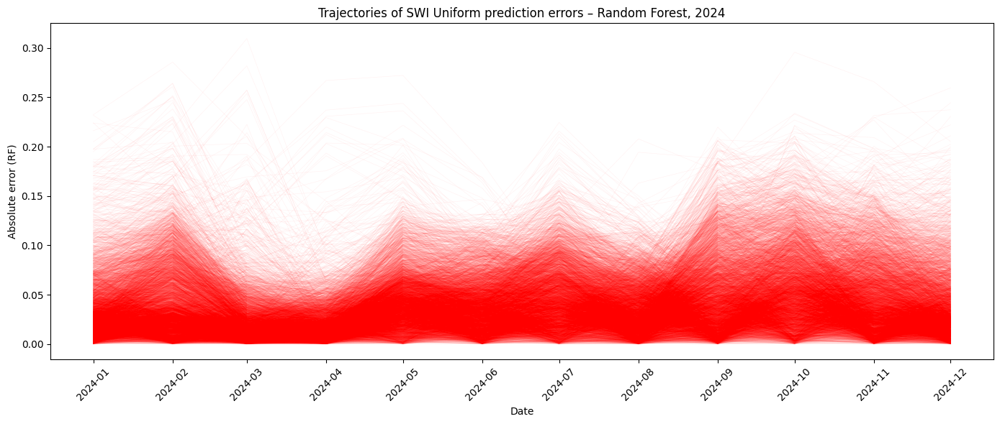

In [38]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# 1. Filtrer 2024
df_2024 = gdf[gdf["ym"].str.startswith("2024")].copy()

# 2. Reconstituer X_2024 comme pour l'entraînement
X_2024 = df_2024[numeric_features + categorical_features]
y_2024 = df_2024["SWI_UNIF_MENS"]

# 3. Prédictions avec le pipeline RF (préprocess + modèle)
y_pred_2024 = rf_pipeline.predict(X_2024)

# 4. Ajouter prédiction et erreur absolue
df_2024["y_pred_rf"] = y_pred_2024
df_2024["error_rf"] = np.abs(df_2024["y_pred_rf"] - y_2024)

# 5. Conversion ym -> datetime
df_2024["ym_dt"] = pd.to_datetime(df_2024["ym"], format="%Y-%m")

# 6. Plot des trajectoires d’erreurs par géométrie
fig, ax = plt.subplots(figsize=(14, 6))

for _, g in df_2024.groupby("geometry"):
    ax.plot(
        g["ym_dt"],
        g["error_rf"],
        linewidth=0.5,
        alpha=0.05,
        color="red"   # pour distinguer du linéaire
    )

ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))

ax.set_xlabel("Date")
ax.set_ylabel("Absolute error (RF)")
ax.set_title("Trajectories of SWI Uniform prediction errors – Random Forest, 2024")

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


Ce graphique montre les trajectoires d’erreur absolue du Random Forest pour tous les points en 2024.

- La majorité des courbes restent dans une bande basse et assez stable, ce qui traduit une bonne précision moyenne sur l’année.  
- On voit toutefois des **pics mensuels récurrents** (par ex. autour de février, mai, juillet et automne) où la « nappe » rouge s’épaissit vers le haut: beaucoup de points ont alors simultanément une erreur plus forte, ce qui suggère des périodes/saisons où les conditions hydrologiques sont plus difficiles à capturer (transition hiver‑printemps, sécheresses estivales, épisodes automnaux).  
- La saisonnalité des erreurs est donc marquée: le modèle reste globalement performant, mais certaines fenêtres temporelles concentrent davantage de risques de mauvaise estimation du SWI Uniforme.
